## Import et définition

In [3]:
import numpy as np
import cupy as cp
import h5py
from matplotlib import pyplot as plt
import read_lif as lif
from skimage import data
import read_lif as lif
from cupyx.scipy import ndimage as ndi
from scipy.ndimage import gaussian_filter
from scipy import ndimage as ndicpu
from cucim.skimage.util import img_as_float32
from matplotlib import animation, rc
from IPython.display import HTML
import cucim.skimage as ski
from itertools import combinations_with_replacement
import time
from matplotlib.patches import Ellipse
from scipy.signal import argrelextrema
%matplotlib inline
import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('pdf', 'svg')
asnumpy = cp.asnumpy
xp=cp
mempool = cp.get_default_memory_pool()
pinned_mempool = cp.get_default_pinned_memory_pool()
plt.rcParams["figure.figsize"]=8,8

In [4]:
def symmetric_image(S_elems):
    """Convert the upper-diagonal elements of a matrix to the full
    symmetric matrix.

    Parameters
    ----------
    S_elems : list of array
        The upper-diagonal elements of the matrix, as returned by
        `hessian_matrix` or `structure_tensor`.

    Returns
    -------
    image : array
        An array of shape ``(M, N[, ...], image.ndim, image.ndim)``,
        containing the matrix corresponding to each coordinate.
    """
    image = S_elems[0]
    symmetric_image = xp.zeros(image.shape + (image.ndim, image.ndim),
                               dtype=S_elems[0].dtype)
    for idx, (row, col) in \
            enumerate(combinations_with_replacement(range(image.ndim), 2)):
        symmetric_image[..., row, col] = S_elems[idx]
        symmetric_image[..., col, row] = S_elems[idx]
    return symmetric_image

def angleentre2vecteurs(v1,v2):
    vector_1 = v1
    vector_2 = v2
    unit_vector_1 = vector_1 / xp.linalg.norm(vector_1)
    unit_vector_2 = vector_2 / xp.linalg.norm(vector_2)
    dot_product = xp.dot(unit_vector_1, unit_vector_2)
    angle = xp.arccos(dot_product)
    return(xp.degrees(angle))

In [7]:
date='20220316'
videolif="/media/keho/My Book/Keho/Yaourt/20220316/Experiment_20220316.lif"
flowh5="/media/keho/My Book/Keho/Yaourt/20220316/flow_20220316.h5"
flowh5='/media/keho/T7/Yaourt/piv-yogurt-master/flowsgpu/20220316flowGPU.h5'
location="/media/keho/My Book/Keho/Yaourt/20220316/"

In [8]:
with h5py.File(flowh5, "r") as h5file:
    print(h5file.keys())
    print(h5file.get("timestamps"))
    print(h5file.get("FlowField3D"))

<KeysViewHDF5 ['FlowField3D', 'timestamps']>
<HDF5 dataset "timestamps": shape (405, 111), type "<f8">
<HDF5 dataset "FlowField3D": shape (404, 111, 512, 512, 3), type "<f4">


In [9]:
with h5py.File(flowh5, "r") as h5file:
    flow=h5file.get("FlowField3D")
    print(flow.attrs.keys())
    print(flow.attrs['Zmax'])
    Zmax=flow.attrs['Zmax']
    Zmin=flow.attrs['Zmin']

<KeysViewHDF5 ['datetime', 'endseries', 'filename', 'no_clean_git', 'output', 'series']>


KeyError: "Can't open attribute (can't locate attribute: 'Zmax')"

## Calcul des maxima et ménage dans ces derniers

In [13]:
rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
ser = rea.getSeries()[2]
px = xp.asarray([ser.getVoxelSize(d+1)*1e6 for d in range(3)[::-1]])
px[0] *= 1.55

sigmaflou = 4
thr=px[1]
Listmax = []
#valeursmax=xp.empty(shape=(1,0))

def local_max(a, size=5, thr=0):
    binary = (ndi.grey_dilation(a, size, mode='constant', cval=a.max()+1) == a) & (a > thr)
    return binary
t1=time.time()
with h5py.File(flowh5, "r") as h5file:
    size=1
    Nstack=len(h5file.get("FlowField3D"))
    print(len(h5file.get("FlowField3D")))
    for t in range(len(h5file.get("FlowField3D"))):
        flow = xp.asarray(h5file.get("FlowField3D")[max(0,t-size):min(t+size+1,len(h5file.get("FlowField3D")))])
        flow *= px
        flow -= flow.mean((2,3))[...,None,None,:]
        flow = ndi.gaussian_filter(flow, (0, sigmaflou, sigmaflou, sigmaflou,0))
        nflow = xp.sqrt((flow**2).sum(-1))
        M = xp.array(xp.where(local_max(nflow,size=(3,7,7,7),thr=thr))).astype('int16').T
        valeursmax = xp.empty((M.shape[0], 4))
        for i, m in enumerate(M):
            valeursmax[i] = xp.concatenate((flow[tuple(m)], xp.array([flow[m[0]].mean()])))
        #valeursmax = xp.array([vflow[tuple(m)] for m in M])
        M[:,0]+=max(0,t-size)
        Listmax.append(xp.hstack((M, valeursmax)))
        # print(M.shape)
        cp._default_memory_pool.free_all_blocks()
        print(f'\r{t}', sep=' ', end=' ', flush=True)
del flow
del nflow
Listmax = xp.vstack(Listmax).T
# Listmax contient t z y x vz vy vx et vmoyen sur le plan
print(time.time()-t1)
px=px.get()

404
403 989.8160145282745


In [ ]:
rea =  lif.Reader('/media/keho/My Book/Keho/Yaourt/'+dateprofile+'/Experiment_'+dateprofile+'.lif', quick=False)
# rea.Series.getTimeStamp()
ser = rea.getSeries()
rea.getTimeStamp()

NameError: name 'dateprofile' is not defined

240.56272727272727
Différence au début :  21.439599999999956
Différence à la fin :  16.845399999999948
Différence minimum :  10.719799999999964
Différence maximum :  52.06759999999983
Écart entre maximum et minimum :  41.347799999999864
Différence moyenne :  28.214993337229597


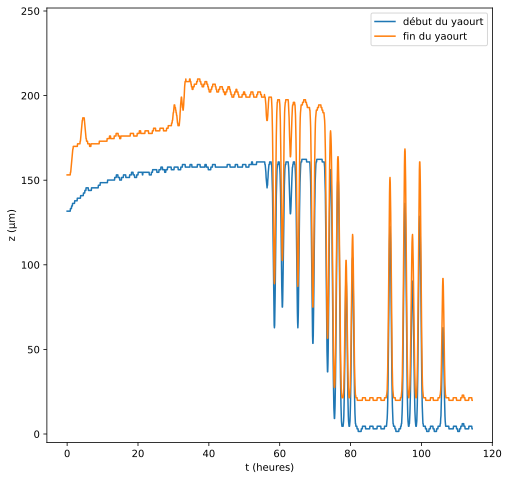

In [28]:
dateprofile='20220525'
rea = lif.Reader('/media/keho/My Book/Keho/Yaourt/'+dateprofile+'/Experiment_'+dateprofile+'.lif', False)
#ser = rea.chooseSerie()
ser = rea.getSeries()[2]
print(ser.getTimeLapse())

px = np.asarray([ser.getVoxelSize(d+1)*1e6 for d in range(3)[::-1]])
px[0] *= 1.55
with h5py.File('/media/keho/My Book/Keho/Yaourt/piv-yogurt-master/flowsgpu/20220331flowGPU.h5', "r") as h5file:
    timestamps=np.array(h5file.get("timestamps"))

profiles=np.load('/media/keho/My Book/Keho/Yaourt/'+dateprofile+'/profiles_'+dateprofile+'.npy')
profiles=gaussian_filter(profiles,1)

tronquerdebut=0
debuttps=10 #permet de sauter les premières séries qui correspondrait à des captures ou des séries de test avant la grande capture. 18 pour 20220316, 10 pour 20220331
debut=[]
fin=[]
for i, profile in enumerate((((profiles.T)[tronquerdebut:]).T)[debuttps:]): 
    # print(i)
    debut.append([k for k in (argrelextrema(profile,np.greater))[0] if np.abs(profile[k])>np.max(profile)/4][0])
    # fin.append((argrelextrema(profile[debut[-1]:],np.less)[0]+debut[-1])[0])
    fin.append((argrelextrema(np.gradient(np.gradient(gaussian_filter(profile[debut[-1]:],4))),np.greater)[0]+debut[-1])[0])
# print(fin)
debut=gaussian_filter(np.array(debut)+tronquerdebut,4)*px[0]
fin=gaussian_filter(np.array(fin)+tronquerdebut,4)*px[0]
debutx=ser.getTimeLapse()*np.linspace(0,len(debut),len(debut))/3600
finx=ser.getTimeLapse()*np.linspace(0,len(fin),len(fin))/3600

plt.plot(debutx,debut,label="début du yaourt")
plt.plot(finx,fin,label='fin du yaourt')
plt.legend()
plt.xlabel("t (heures)")
plt.ylabel("z (µm)")
plt.ylim([-5,np.max(fin)*1.2])
# plt.xlim([1180,1200])
print("Différence au début : ", fin[0]-debut[0])
print("Différence à la fin : ", fin[-1]-debut[-1])
print("Différence minimum : ", np.min(fin-debut))
print("Différence maximum : ", np.max(fin-debut))
print("Écart entre maximum et minimum : ", np.abs(np.min(fin-debut)-np.max(fin-debut)))
print("Différence moyenne : ", np.mean(fin-debut))
plt.savefig('/media/keho/My Book/Keho/Yaourt/'+dateprofile+'/profilesimage_'+dateprofile)
plt.savefig('/media/keho/My Book/Keho/Yaourt/'+dateprofile+'/profilesimage_'+dateprofile+'.pdf')

In [29]:
np.linspace(0,100,100).shape

(100,)

In [ ]:
timestamps

(0.0, 150.0)

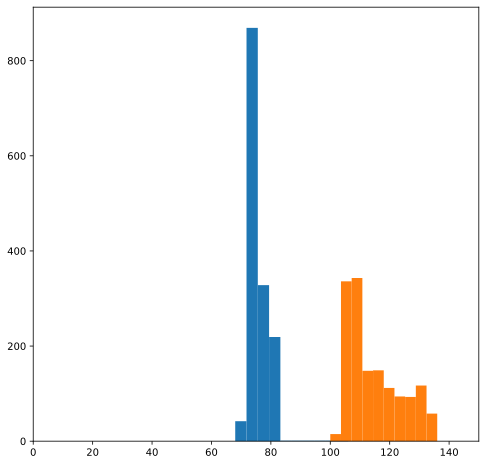

In [318]:
plt.hist(debut)
plt.hist(fin)

plt.xlim([0,150])

In [14]:
xp.asarray([ser.getVoxelSize(d+1)*1e6 for d in range(3)[::-1]])

array([0.988     , 0.75831703, 0.75831703])

In [11]:
Listmax=cp.load("/media/keho/T7/Yaourt/piv-yogurt-master/flowsgpu/"+date+"Listmax.npy")

FileNotFoundError: [Errno 2] No such file or directory: '/media/keho/T7/Yaourt/piv-yogurt-master/flowsgpu/20220331Listmax.npy'

In [25]:
Listmaxnp=Listmax.get()
# Correction sin Zmax Zmin dans l'optical flow
# with h5py.File(flowh5, "r") as h5file:
#     flow=h5file.get("FlowField3D")
#     Listmaxnp[1]+=flow.attrs['Zmin']
print(Listmaxnp.shape)
minz=13
maxz=75
L=[]
for i in range(len(Listmaxnp[0])):
    if Listmax[0][i]<=size:
        L.append(i)
Listmaxnp=np.delete(Listmaxnp,L,axis=-1)
# print(Listmaxnp.shape)
# print(Listmaxnp)
L=[]
for i in range(len(Listmaxnp[0])):
    if Listmaxnp[1][i]<=minz or Listmaxnp[1][i]>=maxz:
        L.append(i)       
# print(L)
Listmaxnp=np.delete(Listmaxnp,L,axis=-1)
# Listmaxnp=np.unique(Listmaxnp,axis=-1)
print(Listmaxnp.shape)
# print(Listmaxnp)
np.save("/media/keho/T7/Yaourt/piv-yogurt-master/flowsgpu/"+date+"Listmaxnp.npy",Listmaxnp)

(8, 142)
(8, 12)


## Représentation maxima sur image avec quiver

In [31]:

rea = lif.Reader("/media/keho/T7/Yaourt/piv-yogurt-master/flowsgpu/20220316_bien.lif", False)
#ser = rea.chooseSerie()
ser = rea.getSeries()[2]
px = np.asarray([ser.getVoxelSize(d+1)*1e6 for d in range(3)[::-1]])
px[0] *= 1.55

In [33]:
Listmaxnp=np.load('/media/keho/T7/Yaourt/piv-yogurt-master/flowsgpu/20220316Listmaxnp.npy')

In [34]:
Listmaxnp.shape

(8, 17)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


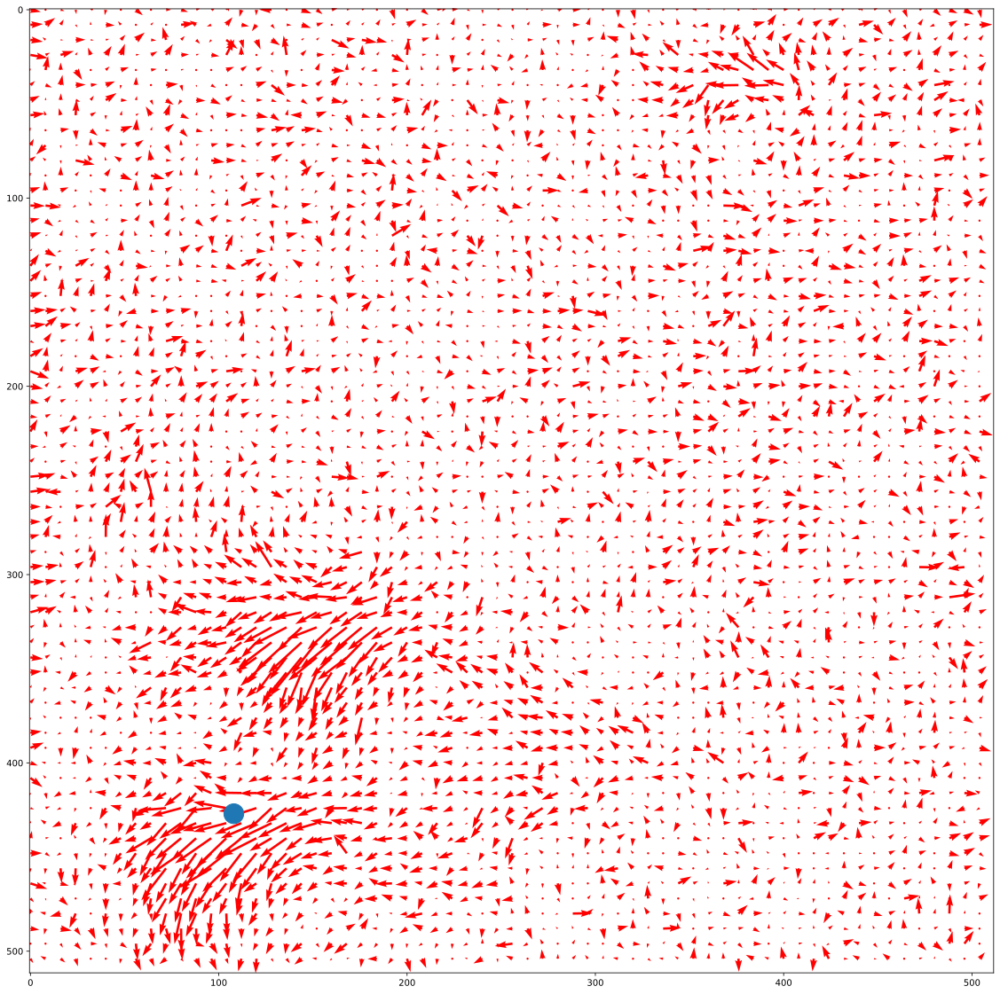

In [36]:
rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
k=16
t,z=[int(Listmaxnp[i][k]) for i in range(2)]
# ser = rea.getSeries()[2]
ser = lif.SerieCollection(rea.getSeries()[2:len(rea.getSeries())+1])
ims = [ser.getFrame(T=t+i)[:] for i in range(2)]
duree=ser.getTotalDuration()

fig = plt.figure(figsize=(20,20))
nvec = 64
nl, nc = ims[0][z].shape
step = max(nl//nvec, nc//nvec)
y, x = np.mgrid[:nl:step, :nc:step]
plt.imshow(1/255*np.dstack([im[z] for im in ims])[...,[0,1,0]].astype(float))
with h5py.File(flowh5, "r") as h5file:
    displYX3D = h5file.get("FlowField3D")[t,z,...]
    w,v,u=(displYX3D[...,i] for i in range(3))
    w*=px[0]
    v*=px[1]
    u*=px[2]
    plt.quiver(x, y, u[y,x]-u.mean(), v[y,x]-v.mean(), color='r', units='dots',
        angles='xy', scale_units='xy', lw=1)
# plt.scatter(*np.flip((np.delete(Listmaxnp,np.logical_or((Listmaxnp[0]!=t), (Listmaxnp[1]!=z)),axis=-1)[2:-1])),s=500)
plt.scatter(*Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)][::-1],s=500)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


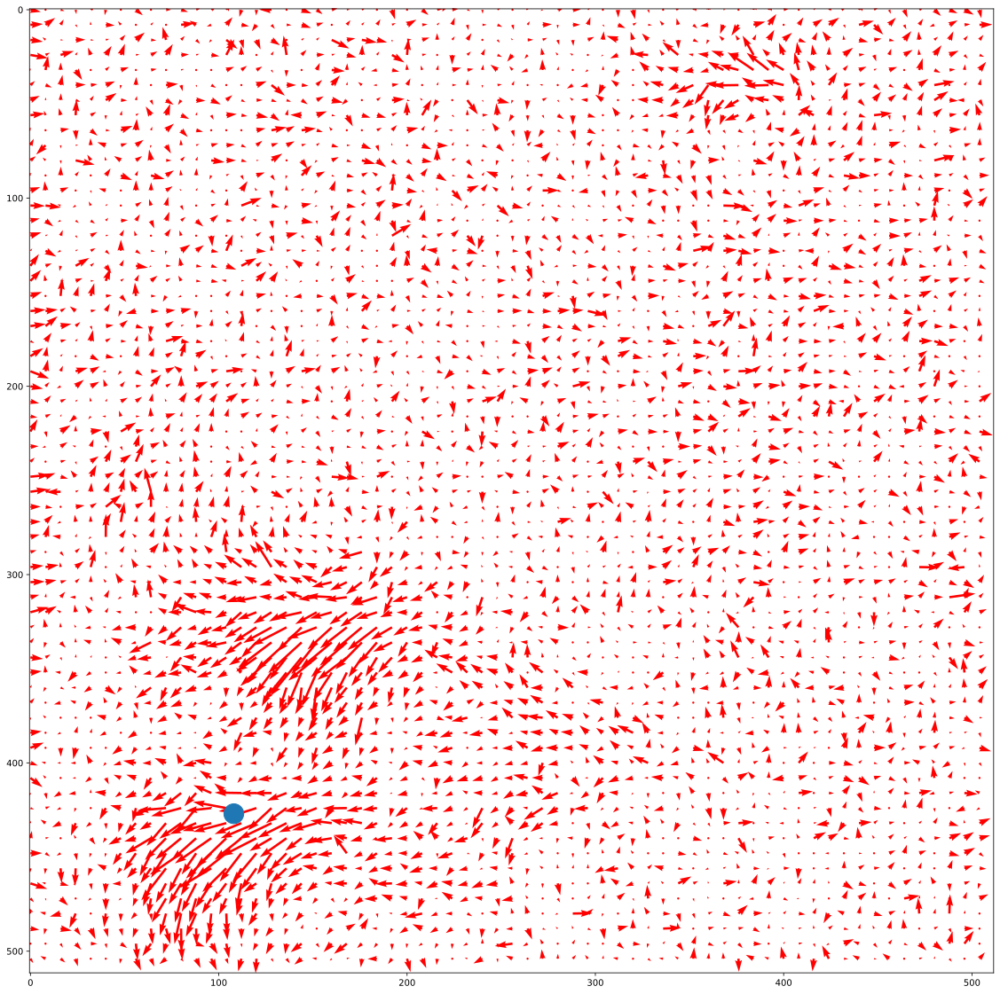

In [36]:
rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
k=16
t,z=[int(Listmaxnp[i][k]) for i in range(2)]
# ser = rea.getSeries()[2]
ser = lif.SerieCollection(rea.getSeries()[2:len(rea.getSeries())+1])
ims = [ser.getFrame(T=t+i)[:] for i in range(2)]
duree=ser.getTotalDuration()

fig = plt.figure(figsize=(20,20))
nvec = 64
nl, nc = ims[0][z].shape
step = max(nl//nvec, nc//nvec)
y, x = np.mgrid[:nl:step, :nc:step]
plt.imshow(1/255*np.dstack([im[z] for im in ims])[...,[0,1,0]].astype(float))
with h5py.File(flowh5, "r") as h5file:
    displYX3D = h5file.get("FlowField3D")[t,z,...]
    w,v,u=(displYX3D[...,i] for i in range(3))
    w*=px[0]
    v*=px[1]
    u*=px[2]
    plt.quiver(x, y, u[y,x]-u.mean(), v[y,x]-v.mean(), color='r', units='dots',
        angles='xy', scale_units='xy', lw=1)
# plt.scatter(*np.flip((np.delete(Listmaxnp,np.logical_or((Listmaxnp[0]!=t), (Listmaxnp[1]!=z)),axis=-1)[2:-1])),s=500)
plt.scatter(*Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)][::-1],s=500)

## Représentation sur image avec quiver des maxima avec les ellipses de vecteurs propres de la hessienne

In [ ]:
#Calcul matrice hessienne
rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
k=8
t,z=[int(Listmaxnp[i][k]) for i in range(2)]
# ser = rea.getSeries()[2]
ser = lif.SerieCollection(rea.getSeries()[:len(rea.getSeries())+1])
ims = [ser.getFrame(T=t+i)[:] for i in range(2)]
duree=ser.getTotalDuration()

fig, ax = plt.subplots(figsize=(20,20))
nvec = 64
nl, nc = ims[0][z].shape
step = max(nl//nvec, nc//nvec)
y, x = np.mgrid[:nl:step, :nc:step]
# plt.imshow(1/255*np.dstack([im[z] for im in ims])[...,[0,1,0]].astype(float))
im=ims[0]
plt.imshow(1/255*im[z].astype(float),cmap='gray')

print(ims[0].shape)
im=xp.array(ims[0])
H=ski.feature.hessian_matrix(im, sigma=4,order='xy')
H=symmetric_image(H)
print(H.shape)
l,V=xp.linalg.eigh(xp.linalg.inv(H[z-Zmin]),'U')


lmax=l[tuple(Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)].astype('int').T[0])]
Vmax=V[tuple(Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)].astype('int').T[0])]
isort=np.argsort(np.abs(lmax))
lmax=lmax[isort]
Vmax=Vmax.T[isort].T

ellipse=Ellipse(tuple(Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)].astype('int').T[0][::-1]),0.002*xp.abs(lmax[2]),0.002*xp.abs(lmax[1]),
                xp.degrees(xp.arctan2(Vmax[1,2], Vmax[2,2])),edgecolor='magenta',facecolor='none',linewidth=4)
ax.add_patch(ellipse)

with h5py.File(flowh5, "r") as h5file:
    displYX3D = ndicpu.gaussian_filter(h5file.get("FlowField3D")[t,z-Zmin,...],sigma=(4,4,0))
    w,v,u=(displYX3D[...,i] for i in range(3))
    w*=px[0]
    v*=px[1]
    u*=px[2]
    ax.quiver(x, y, u[y,x]-u.mean(), v[y,x]-v.mean(), color='r', units='dots',
        angles='xy', scale_units='xy', lw=1)
# plt.scatter(*np.flip((np.delete(Listmaxnp,np.logical_or((Listmaxnp[0]!=t), (Listmaxnp[1]!=z)),axis=-1)[2:-1])),s=500)
ax.add_patch(ellipse)
ax.scatter(*Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)][::-1],s=250)
x0,y0=Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)][::-1]

mempool.free_all_blocks()
pinned_mempool.free_all_blocks()

# ax.set_xlim([x0-50,x0+50])
# ax.set_ylim([y0-50,y0+50])

(174, 512, 512)
(174, 512, 512, 3, 3)


In [8]:
cp._default_memory_pool.free_all_blocks()

mempool.free_all_blocks()
pinned_mempool.free_all_blocks()

## Calcul répartition angles en 3D sur les maxima

17
16 

(0.0, 90.0)

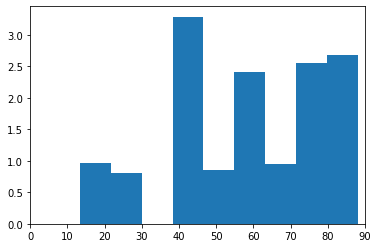

In [10]:
#Calculer distribution angle entre les v de plus grandes valeurs propres avec la vitesse non affine d'abord sur les max et ensuite sur l'ensemble des points
def sym(a,alim):
    if a>alim:
        return(a-2*np.abs(a-alim))
    return(a)

print(len(Listmaxnp.T))
Angles=[]
Poids=[]
sigmaflou=4

for k in range(len(Listmaxnp[0])):
    t0,z0,y0,x0=Listmaxnp.T[k,:4].astype('int')
    ser = lif.SerieCollection(rea.getSeries()[2:len(rea.getSeries())+1])
    im = xp.array(ser.getFrame(T=t0))
    duree=ser.getTotalDuration()
    H=ski.feature.hessian_matrix(im, sigma=4,order='xy')
    H=symmetric_image(H)
    print(f'\r{k}', sep=' ', end=' ', flush=True)
    l,V=xp.linalg.eigh(xp.linalg.inv(H[z0,y0,x0]),'U')
    isort=np.argsort(np.abs(l))
    l=l[isort]
    V=V.T[isort].T
    Angles.append(sym(angleentre2vecteurs((xp.array(Listmaxnp.T[k,4:7])),V[0]),90))
    Poids.append(np.linalg.norm((Listmaxnp.T[k,4:7])))

mempool.free_all_blocks()
pinned_mempool.free_all_blocks()    
Angles=xp.array(Angles).get()
Poids=np.array(Poids)
#x0,y0,z0(,t0)=valeurs
plt.hist(Angles,weights=Poids,bins=9)
plt.xlim([0,90])

17
16 

(0.0, 90.0)

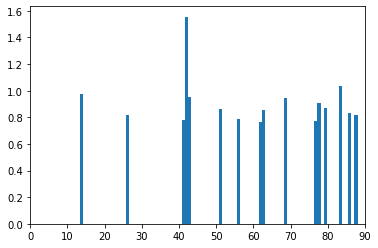

In [12]:
#Calculer distribution angle entre les v de plus grandes valeurs propres avec la vitesse non affine d'abord sur les max et ensuite sur l'ensemble des points
def sym(a,alim):
    if a>alim:
        return(a-2*np.abs(a-alim))
    return(a)

print(len(Listmaxnp.T))
Angles=[]
Poids=[]
sigmaflou=4

for k in range(len(Listmaxnp[0])):
    t0,z0,y0,x0=Listmaxnp.T[k,:4].astype('int')
    ser = lif.SerieCollection(rea.getSeries()[2:len(rea.getSeries())+1])
    im = xp.array(ser.getFrame(T=t0))
    duree=ser.getTotalDuration()
    H=ski.feature.hessian_matrix(im, sigma=4,order='xy')
    H=symmetric_image(H)
    print(f'\r{k}', sep=' ', end=' ', flush=True)
    l,V=xp.linalg.eigh(xp.linalg.inv(H[z0,y0,x0]),'U')
    isort=np.argsort(np.abs(l))
    l=l[isort]
    V=V.T[isort].T
    Angles.append(sym(angleentre2vecteurs((xp.array(Listmaxnp.T[k,4:7])),V[0]),90))
    Poids.append(np.linalg.norm((Listmaxnp.T[k,4:7])))

mempool.free_all_blocks()
pinned_mempool.free_all_blocks()    
Angles=xp.array(Angles).get()
Poids=np.array(Poids)
#x0,y0,z0(,t0)=valeurs
plt.hist(Angles,weights=Poids,bins=90)
plt.xlim([0,90])

## Calcul répartition angles en 3D

In [ ]:
rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
ser = rea.getSeries()[2]
px = xp.asarray([ser.getVoxelSize(d+1)*1e6 for d in range(3)[::-1]])
px[0] *= 1.55

def sym(a,alim):
    if a>alim:
        return(a-2*np.abs(a-alim))
    return(a)

Angles=[]
Poids=[]
sigmaflou = 4
Listhist=[]

t1=time.time()
with h5py.File(flowh5, "r") as h5file:
    size=1
    Nstack=len(h5file.get("FlowField3D"))
    print(len(h5file.get("FlowField3D")))
    for t in range(len(h5file.get("FlowField3D"))):
        Angles=[]
        Poids=[]
        flow = xp.asarray(h5file.get("FlowField3D")[t])
        flow *= px
        flow -= flow.mean((1,2))[...,None,None,:]
        flow = ndi.gaussian_filter(flow, (sigmaflou, sigmaflou, sigmaflou, 0))
        nflow = xp.sqrt((flow**2).sum(-1))
        
        ser = lif.SerieCollection(rea.getSeries()[2:len(rea.getSeries())+1])
        im = xp.array(ser.getFrame(T=t))
        duree=ser.getTotalDuration()
        H=ski.feature.hessian_matrix(im, sigma=4,order='xy')
        H=symmetric_image(H)
        
        for z0 in range(len(im)):
            for y0 in range(len(im[0])):
                print(f'\r{y0}', sep=' ', end=' ', flush=True)
                for x0 in range(len(im[0,0])):
                    l,V=xp.linalg.eigh(xp.linalg.inv(H[z0,y0,x0]),'U')
                    isort=np.argsort(np.abs(l))
                    l=l[isort]
                    V=V.T[isort].T
                    Angles.append(sym(angleentre2vecteurs((flow[z0,y0,x0]),V[0]),90))
                    Poids.append(np.linalg.norm((flow[z0,y0,x0])))
        # print(M.shape)
        cp._default_memory_pool.free_all_blocks()
        hist=plt.hist(Angles,weights=Poids,bins=90)
        Listhist.append(hist)
        print(f'\r{t}', sep=' ', end=' ', flush=True)

    
del flow
del nflow
Listmax = xp.vstack(Listmax).T
print(time.time()-t1)
px=px.get()

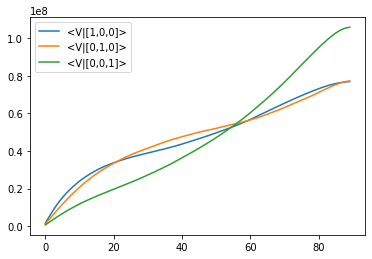

In [27]:
# Sans correction en z
plt.plot(histz[:,50:90].sum(axis=(0,1)),label="<V|[1,0,0]>")
plt.plot(histy[:,50:90].sum(axis=(0,1)),label="<V|[0,1,0]>")
plt.plot(histx[:,50:90].sum(axis=(0,1)),label="<V|[0,0,1]>")
plt.legend()

## Calcul répartition angles en 3D

In [20]:
# Par rapport au vecteur vitesse

rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
ser = rea.getSeries()[2]
px = xp.asarray([ser.getVoxelSize(d+1)*1e6 for d in range(3)[::-1]])
px[0] *= 1.55
px=px.astype('float32')

def sym(a,alim):
    return(xp.where(a>alim,a-2*np.abs(a-alim),a))

def angleentre2vecteursmultid(v1,v2):
    uv1 = v1 / xp.sqrt((v1**2).sum(axis=-1))[...,None]
    uv2 = v2 / xp.sqrt((v2**2).sum(axis=-1))[...,None]
    dot_product = (uv1*uv2).sum(axis=-1)
    angle = xp.arccos(dot_product)
    return xp.degrees(angle)

with h5py.File(flowh5, "r") as h5file:
    Nstack=len(h5file.get("FlowField3D"))
    # flow=xp.zeros(h5file.get("FlowField3D").shape)
ser = lif.SerieCollection(rea.getSeries()[2:len(rea.getSeries())+1])
sigmaflou = 4
bins=xp.arange(91)
hist=np.empty((Nstack,ser.getFrameShape()[0],len(bins)-1))


t1=time.time()
with h5py.File(flowh5, "r") as h5file:
    print(len(h5file.get("FlowField3D")))
    for t in range(len(h5file.get("FlowField3D"))):
        flow = xp.asarray(h5file.get("FlowField3D")[t])
        flow *= px
        flow -= flow.mean((1,2))[...,None,None,:]
        ndi.gaussian_filter(flow, (sigmaflou, sigmaflou, sigmaflou, 0),output=flow)
        im = xp.array(ser.getFrame(T=t).astype('float32'))
        duree=ser.getTotalDuration()
        H=ski.feature.hessian_matrix(im, sigma=4,order='xy')
        H=symmetric_image(H)
        H *= 1/(px * px[:,None])

        for z0 in range(len(im)):
            # print(f'\r{z0}', sep=' ', end=' ', flush=True)
            l,V=xp.linalg.eigh(H[z0],'U')
            l=l**-1
            isort=xp.abs(l).argsort(axis=-1)
            l=xp.take_along_axis(l, isort, axis=-1)
            # isort=np.argsort(np.abs(l))
            # l=l[isort]
            V=xp.take_along_axis(V,xp.transpose(xp.repeat(isort[...,None],3,axis=-1),(0,1,3,2)),axis=-1)
            # V[...,isort]
            # V=V.T[isort].T
            Angles=sym(angleentre2vecteursmultid(flow[z0],V[...,0]),90)
            Poids=xp.sqrt((flow[z0]**2).sum(axis=-1))
            hist[t,z0]=xp.histogram(Angles,bins,weights=Poids)[0].get()
        # print(M.shape)
        print(f'\r{t}', sep=' ', end=' ', flush=True)

    
del flow
print(time.time()-t1)
mempool.free_all_blocks()
pinned_mempool.free_all_blocks()

404
403 544.1345717906952


In [23]:

rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
ser = rea.getSeries()[2]
px = xp.asarray([ser.getVoxelSize(d+1)*1e6 for d in range(3)[::-1]])
px[0] *= 1.55
px=px.astype('float32')

def sym(a,alim):
    return(xp.where(a>alim,a-2*np.abs(a-alim),a))

def angleentre2vecteursmultid(v1,v2):
    uv1 = v1 / xp.sqrt((v1**2).sum(axis=-1))[...,None]
    uv2 = v2 / xp.sqrt((v2**2).sum(axis=-1))[...,None]
    dot_product = (uv1*uv2).sum(axis=-1)
    angle = xp.arccos(dot_product)
    return xp.degrees(angle)

with h5py.File(flowh5, "r") as h5file:
    Nstack=len(h5file.get("FlowField3D"))
    # flow=xp.zeros(h5file.get("FlowField3D").shape)
ser = lif.SerieCollection(rea.getSeries()[2:len(rea.getSeries())+1])
sigmaflou = 4
bins=xp.arange(91)
histx=np.empty((Nstack,ser.getFrameShape()[0],len(bins)-1))
histy=np.empty((Nstack,ser.getFrameShape()[0],len(bins)-1))
histz=np.empty((Nstack,ser.getFrameShape()[0],len(bins)-1))
PX=xp.array([[px[0]*px[0],px[0]*px[1],px[0]*px[2]],[px[1]*px[0],px[1]*px[1],px[1]*px[2]],[px[2]*px[0],px[2]*px[1],px[2]*px[2]]])

t1=time.time()
with h5py.File(flowh5, "r") as h5file:
    print(len(h5file.get("FlowField3D")))
    for t in range(len(h5file.get("FlowField3D"))):
        im = xp.array(ser.getFrame(T=t).astype('float32'))
        duree=ser.getTotalDuration()
        H=ski.feature.hessian_matrix(im, sigma=4,order='xy')
        H=symmetric_image(H)
        H *= 1/(px * px[:,None])

        for z0 in range(len(im)):
            # print(f'\r{z0}', sep=' ', end=' ', flush=True)
            l,V=xp.linalg.eigh(H[z0],'U')
            l=l**-1
            isort=xp.abs(l).argsort(axis=-1)
            l=xp.take_along_axis(l, isort, axis=-1)
            # isort=np.argsort(np.abs(l))
            # l=l[isort]
            V=xp.take_along_axis(V,xp.transpose(xp.repeat(isort[...,None],3,axis=-1),(0,1,3,2)),axis=-1)
            # V[...,isort]
            # V=V.T[isort].T
            Anglesx=sym(angleentre2vecteursmultid(xp.array([1,0,0]),V[...,0]),90)
            Anglesy=sym(angleentre2vecteursmultid(xp.array([0,1,0]),V[...,0]),90)
            Anglesz=sym(angleentre2vecteursmultid(xp.array([0,0,1]),V[...,0]),90)
            # Poids=xp.sqrt((flow[z0]**2).sum(axis=-1))
            histx[t,z0]=xp.histogram(Anglesx,bins)[0].get()
            histy[t,z0]=xp.histogram(Anglesy,bins)[0].get()
            histz[t,z0]=xp.histogram(Anglesz,bins)[0].get()
        # print(M.shape)
        print(f'\r{t}', sep=' ', end=' ', flush=True)

    
# del flow
# del nflow
print(time.time()-t1)
mempool.free_all_blocks()
pinned_mempool.free_all_blocks()

404
2 

KeyboardInterrupt: 

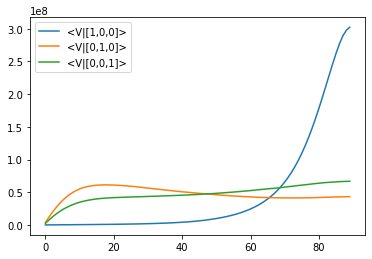

In [19]:
# Avec correction en z
plt.plot(histx[:,50:90].sum(axis=(0,1)),label="<V|[1,0,0]>")
plt.plot(histy[:,50:90].sum(axis=(0,1)),label="<V|[0,1,0]>")
plt.plot(histz[:,50:90].sum(axis=(0,1)),label="<V|[0,0,1]>")
plt.legend()

## Calcul répartition angles en 2D

In [5]:
rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
ser = rea.getSeries()[2]
px = xp.asarray([ser.getVoxelSize(d+1)*1e6 for d in range(3)[::-1]])
px[0] *= 1.55
px=px.astype('float32')

def sym(a,alim):
    return(xp.where(a>alim,a-2*np.abs(a-alim),a))

def angleentre2vecteursmultid(v1,v2):
    uv1 = v1 / xp.sqrt((v1**2).sum(axis=-1))[...,None]
    uv2 = v2 / xp.sqrt((v2**2).sum(axis=-1))[...,None]
    dot_product = (uv1*uv2).sum(axis=-1)
    angle = xp.arccos(dot_product)
    return xp.degrees(angle)

with h5py.File(flowh5, "r") as h5file:
    Nstack=len(h5file.get("FlowField3D"))
    # flow=xp.zeros(h5file.get("FlowField3D").shape)
ser = lif.SerieCollection(rea.getSeries()[:len(rea.getSeries())+1])
sigmaflou = 4
bins=xp.arange(91)
histx=np.empty((Nstack,ser.getFrameShape()[0],len(bins)-1))
histy=np.empty((Nstack,ser.getFrameShape()[0],len(bins)-1))
PX=xp.array([[px[0]*px[0],px[0]*px[1],px[0]*px[2]],[px[1]*px[0],px[1]*px[1],px[1]*px[2]],[px[2]*px[0],px[2]*px[1],px[2]*px[2]]])
zmax=xp.array(ser.getFrame(T=0).astype('float32')).shape[0]

t1=time.time()
with h5py.File(flowh5, "r") as h5file:
    print(len(h5file.get("FlowField3D")))
    for t in range(len(h5file.get("FlowField3D"))):
        im = xp.array(ser.getFrame(T=t).astype('float32'))
        duree=ser.getTotalDuration()
        H=ski.feature.hessian_matrix(im, sigma=4,order='xy')
        H=(symmetric_image(H))[...,1:,1:]
        for z0 in range(zmax):
            # H *= 1/((px[1:] * px[1:,None])) pas forcément utile dans le cadre où en 2d les axes sont équivalents
            # print(f'\r{z0}', sep=' ', end=' ', flush=True)
            l,V=xp.linalg.eigh(H[z0],'U')
            #Vc=V.get() permet de récupérer V avant le tri pour debug
            l=l**-1
            isort=xp.abs(l).argsort(axis=-1)
            l=xp.take_along_axis(l, isort, axis=-1)
            # isort=np.argsort(np.abs(l))
            # l=l[isort]
            V=xp.take_along_axis(V,xp.transpose(xp.repeat(isort[...,None],2,axis=-1),(0,1,3,2)),axis=-1)
            # V=V[...,isort]
            # V=V.T[isort].T
            Anglesy=sym(angleentre2vecteursmultid(xp.array([1,0]),V[...,0]),90)
            Anglesx=sym(angleentre2vecteursmultid(xp.array([0,1]),V[...,0]),90)
            # Poids=xp.sqrt((flow[z0]**2).sum(axis=-1))
            histx[t,z0]=xp.histogram(Anglesx,bins)[0].get()
            histy[t,z0]=xp.histogram(Anglesy,bins)[0].get()
        # print(M.shape)
        print(f'\r{t}', sep=' ', end=' ', flush=True)

    
# del flow
# del nflow
print(time.time()-t1)
mempool.free_all_blocks()
pinned_mempool.free_all_blocks()

404
403 251.71930599212646


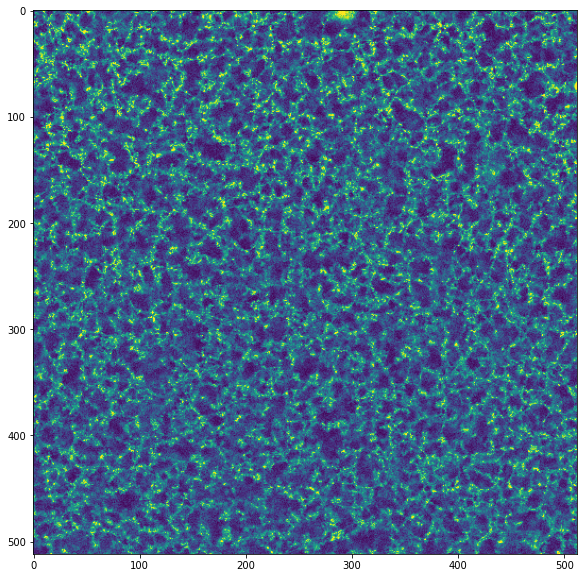

In [8]:
fig=plt.figure(figsize=(10,10))
plt.imshow(np.array(ser.getFrame(T=19).astype('float32')[55]))

In [28]:
histx.shape

(404, 111, 90)

max/min=1.6083792437302922


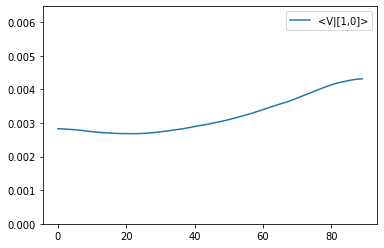

In [90]:
histo=histx[80:,50:90].sum(axis=(0,1))/histx.sum()
plt.plot(histo,label="<V|[1,0]>")
# plt.plot(histy[:,50:90].sum(axis=(0,1)),label="<V|[0,1]>")
plt.ylim([0,histo.max()*1.5])
print('max/min='+str(histo.max()/histo.min()))
plt.legend()

max/min=1.1613436567465119


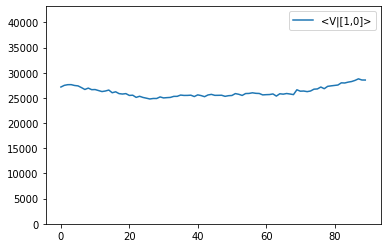

In [91]:
histo=histx[16,0:9].sum(axis=(0))
plt.plot(histo,label="<V|[1,0]>")
# plt.plot(histy[:,50:90].sum(axis=(0,1)),label="<V|[0,1]>")
plt.ylim([0,histo.max()*1.5])
print('max/min='+str(histo.max()/histo.min()))
plt.legend()

(1, 5000000.0)

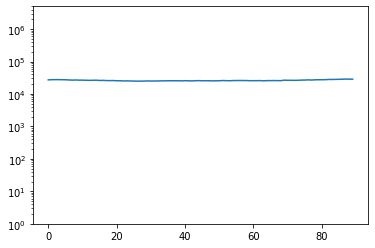

In [76]:
plt.semilogy(histx[16,0:9].sum(axis=(0)),label="<V|[1,0]>")
plt.ylim([1,5e6])

max/min=1.125528148909444
max/min=1.4197904356732056
max/min=1.6489223707842746
max/min=1.5378334063864671


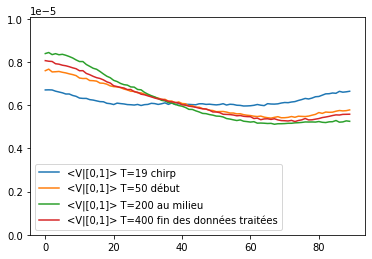

In [21]:
histo1=histy[19,50:75].sum(axis=(0))/histy.sum()
histo2=histy[50,50:75].sum(axis=(0))/histy.sum()
histo3=histy[200,50:75].sum(axis=(0))/histy.sum()
histo4=histy[400,50:75].sum(axis=(0))/histy.sum()
plt.plot(histo1,label="<V|[0,1]> T=19 chirp")
plt.plot(histo2,label="<V|[0,1]> T=50 début")
plt.plot(histo3,label="<V|[0,1]> T=200 au milieu")
plt.plot(histo4,label="<V|[0,1]> T=400 fin des données traitées")
# plt.plot(histy[:,50:90].sum(axis=(0,1)),label="<V|[0,1]>")
plt.ylim([0,histo1.max()*1.5])
print('max/min='+str(histo1.max()/histo1.min()))
print('max/min='+str(histo2.max()/histo2.min()))
print('max/min='+str(histo3.max()/histo3.min()))
print('max/min='+str(histo4.max()/histo4.min()))
plt.legend()

In [14]:
histy.shape

(404, 111, 90)

In [29]:
xp.repeat(isort[...,None],2,axis=-1).shape

(512, 512, 2, 2)

In [31]:
xp.transpose(xp.repeat(isort[...,None],2,axis=-1),(0,1,3,2)).shape

(512, 512, 2, 2)

In [22]:
isort.shape

(512, 512, 2)

In [23]:
l.shape

(512, 512, 2)

In [24]:
V.shape

(512, 512, 2, 2)

In [18]:
px[:] * px[:,None]

array([[3.1015081 , 1.3354797 , 1.3354797 ],
       [1.3354797 , 0.57504475, 0.57504475],
       [1.3354797 , 0.57504475, 0.57504475]], dtype=float32)

In [15]:
px

array([1.76111   , 0.75831705, 0.75831705], dtype=float32)

In [6]:
cp._default_memory_pool.free_all_blocks()

mempool.free_all_blocks()
pinned_mempool.free_all_blocks()

(100.0, 200.0)

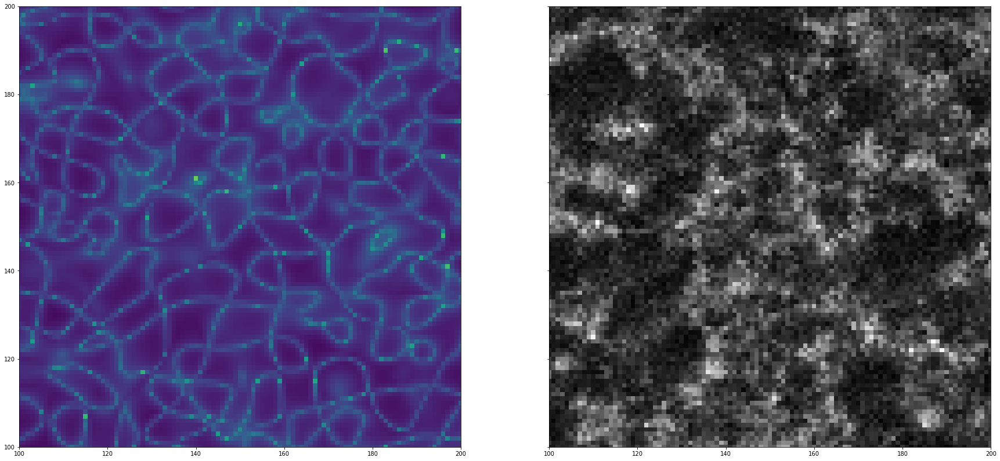

In [131]:
xp.abs(l).max(axis=-1).shape
fig, axs=plt.subplots(1, 2, figsize=(30,15), sharex=True, sharey=True)
axs[0].imshow(xp.log10(xp.abs(l).max(axis=-1)).get())
axs[1].imshow(1/255*im[z].astype(float).get(),cmap='gray')
plt.xlim([100,200])
plt.ylim([100,200])

(100.0, 200.0)

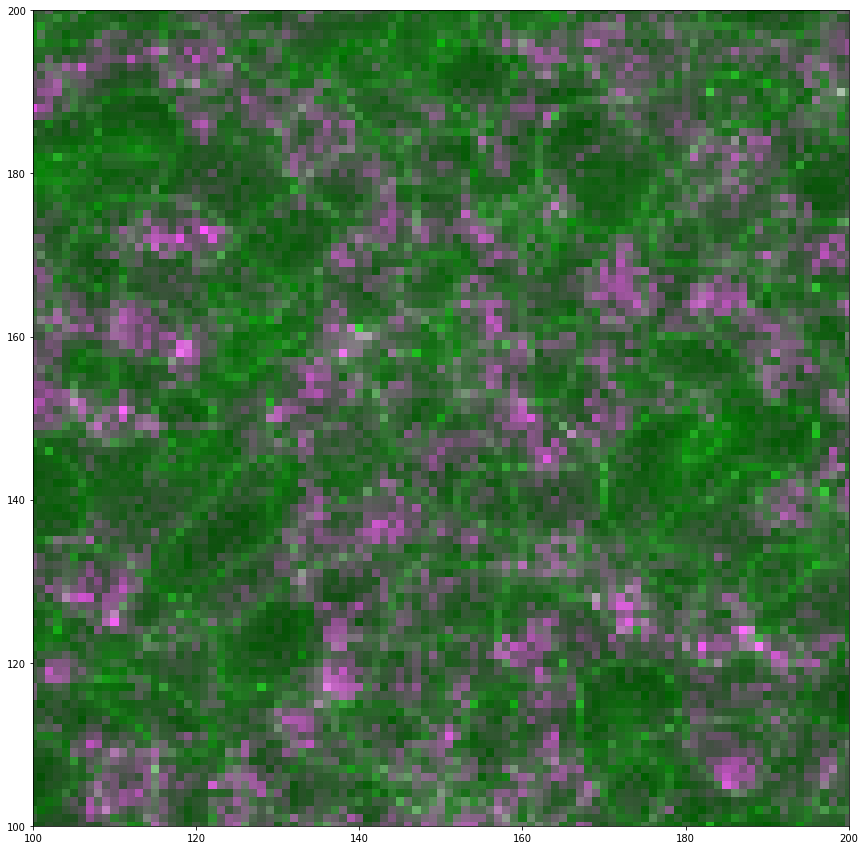

In [138]:
fig = plt.figure(figsize=(15,15))
m = xp.log10(xp.abs(l).max(axis=-1)).max()
plt.imshow(np.dstack((
    1/255*im[z].astype(float).get(),
    (xp.log10(xp.abs(l).max(axis=-1))/m).get(),
    1/255*im[z].astype(float).get()
)))
plt.xlim([100,200])
plt.ylim([100,200])

In [97]:
lmax

array([ -59193.92162063, -108438.53250537, -266091.5511571 ])

(111, 512, 512)
(80, 512, 512, 3, 3)


(20.0, 120.0)

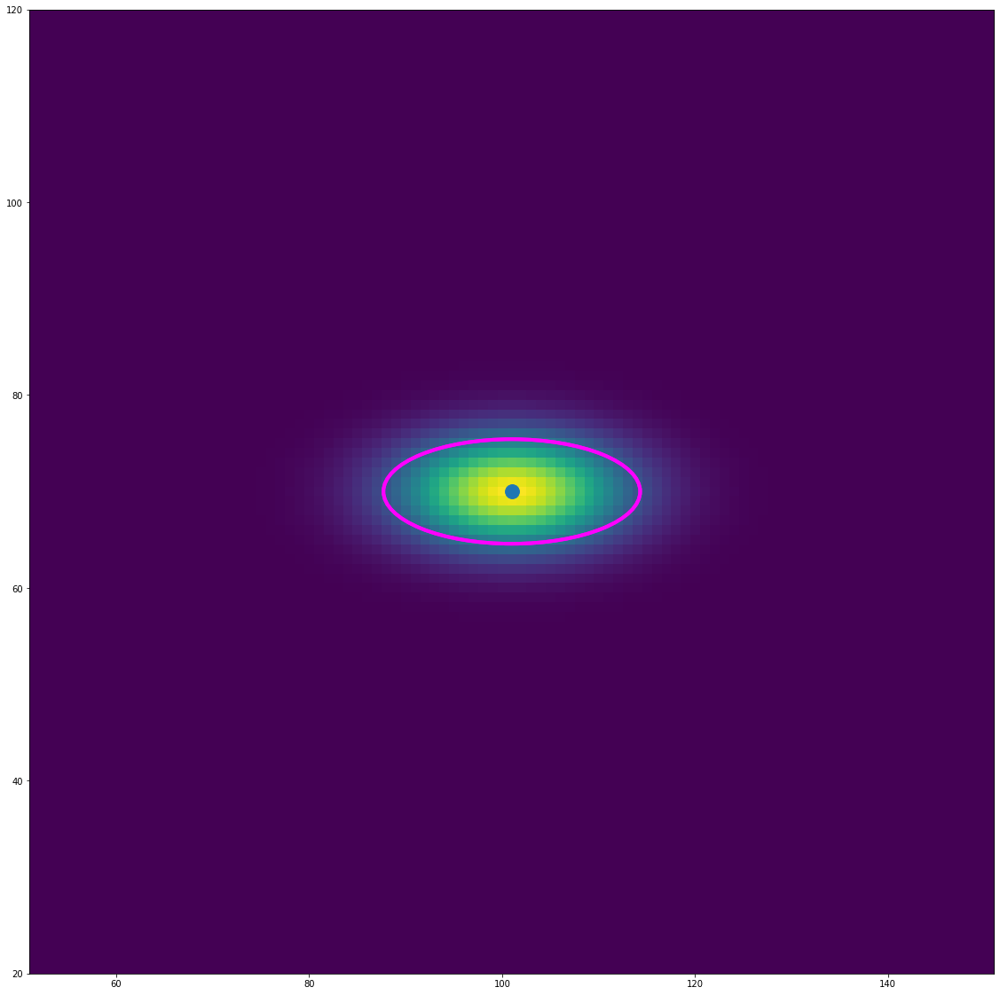

In [99]:
#Calcul matrice hessienne
rea = lif.Reader(videolif, False)
#ser = rea.chooseSerie()
k=4
t,z=[int(Listmaxnp[i][k]) for i in range(2)]
# ser = rea.getSeries()[2]
ser = lif.SerieCollection(rea.getSeries()[2:len(rea.getSeries())+1])
x0,y0=Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)][::-1]
duree=ser.getTotalDuration()

fig, ax = plt.subplots(figsize=(20,20))

# plt.imshow(1/255*np.dstack([im[z] for im in ims])[...,[0,1,0]].astype(float))


print(ims[0].shape)
shape = ser.getFrameShape()
shape[0] = 80
im=xp.zeros(shape)
im[z,int(y0),int(x0)]=1
im=ndi.gaussian_filter(im,sigma=(1,4,8))
H=ski.feature.hessian_matrix(im, sigma=4)
H=symmetric_image(H)
print(H.shape)
lmax,Vmax=xp.linalg.eigh(xp.linalg.inv(H[z,int(y0),int(x0)]),'U')
plt.imshow(1/255*im[z].get().astype(float))

# lmax=l[tuple(Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)].astype('int').T[0][::-1])]
# Vmax=V[tuple(Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)].astype('int').T[0][::-1])]
isort=np.argsort(np.abs(lmax))
lmax=lmax[isort]
Vmax=Vmax.T[isort].T

ellipse=Ellipse(tuple(Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)].astype('int').T[0][::-1]),1e-4*xp.abs(lmax[2]),1e-4*xp.abs(lmax[1]),
                xp.degrees(xp.arctan2(Vmax[1,2], Vmax[2,2])),edgecolor='magenta',facecolor='none',linewidth=4)
ax.add_patch(ellipse)


# plt.scatter(*np.flip((np.delete(Listmaxnp,np.logical_or((Listmaxnp[0]!=t), (Listmaxnp[1]!=z)),axis=-1)[2:-1])),s=500)
ax.add_patch(ellipse)
ax.scatter(*Listmaxnp[2:4,(Listmaxnp[0]==t) & (Listmaxnp[1]==z)][::-1],s=250)


ax.set_xlim([x0-50,x0+50])
ax.set_ylim([y0-50,y0+50])

(3, 45)


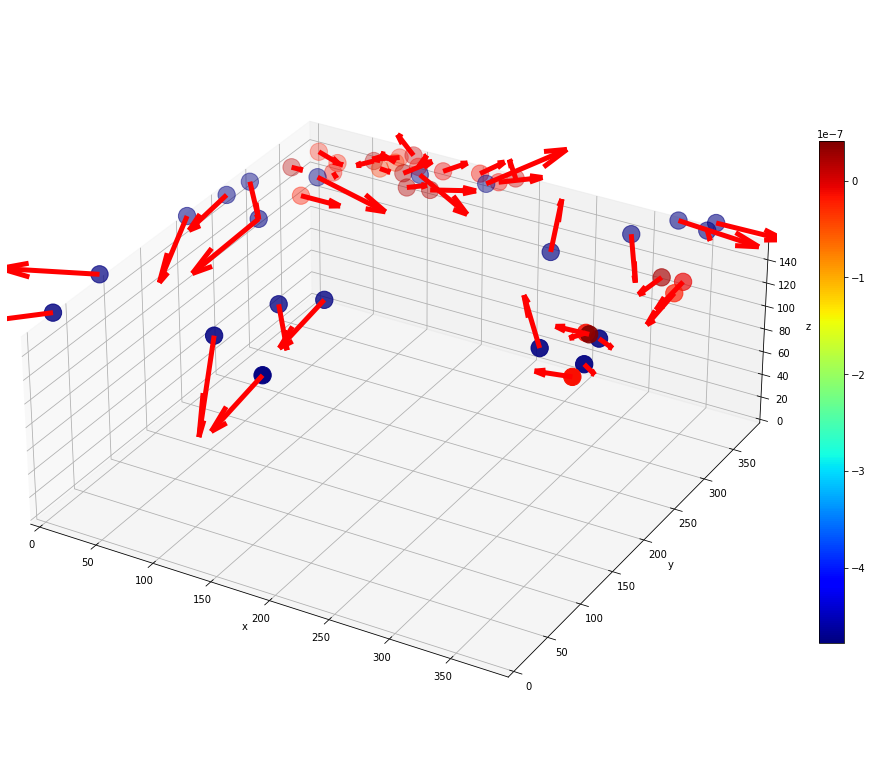

In [83]:
# plt.scatter(*(np.flip(Listmaxnp[1:])),projection='3d')

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111,projection='3d')

V=np.fliplr(Listmaxnp[-3:])
# V=np.swapaxes(np.array(V),0,1)
print(V.shape)
a=ax.scatter(*(np.flip(Listmaxnp[1:-4]*px.reshape(3,1))),c=Listmaxnp[-1],cmap='jet',s=300)
ax.quiver(*(np.flip(Listmaxnp[1:-4]*px.reshape(3,1))), *(V*100), color='r', lw=5,)
fig.colorbar(a,fraction=0.03)


ax.set_xlabel('x')
ax.set_xlim(0,512*px[2])
ax.set_ylabel('y')
ax.set_ylim(0,512*px[1])
ax.set_zlabel('z')
ax.set_zlim(0,100*px[0])
ax.set_box_aspect((512*px[2],512*px[1],100*px[0]))

plt.show()

In [86]:
V.T[0]

array([ 6.95496798e-02,  2.66312629e-01, -4.77961748e-07])

IndexError: Index (112) out of range for (0-105)

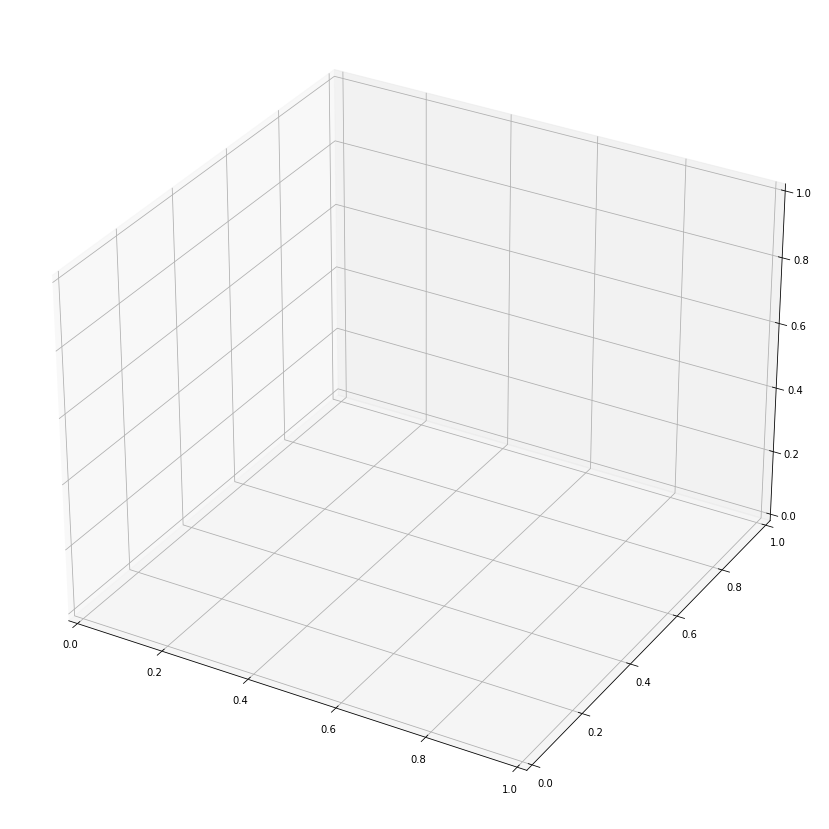

In [58]:
# plt.scatter(*(np.flip(Listmaxnp[1:])),projection='3d')

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111,projection='3d')



L=[]
V=[]
for i in range(len(Listmaxnp[0])):
    L.append(tuple(Listmaxnp[:-1,i].astype('int16')))
for i in L:
    with h5py.File(flowh5, "r") as h5file:
        displ = h5file.get("FlowField3D")[i]
        # w,v,u=(displ[...,j] for j in range(3))
        # w*=px[0]
        # v*=px[1]
        # u*=px[2]
        # V.append(np.array([u,v,w]))
        V.append(displ*px)

V=np.swapaxes(np.array(V),0,1)
print(V.shape)
print(np.flip(Listmaxnp[1:-1]).shape)

a=ax.scatter(*(np.flip(Listmaxnp[1:-1]*px.reshape(3,1))),c=Listmaxnp[-1],cmap='jet',s=300)
ax.quiver(*(np.flip(Listmaxnp[1:-1]*px.reshape(3,1))), *V, color='r', lw=5,length=80)
fig.colorbar(a,fraction=0.03)


ax.set_xlabel('x')
ax.set_xlim(0,512*px[2])
ax.set_ylabel('y')
ax.set_ylim(0,512*px[1])
ax.set_zlabel('z')
ax.set_zlim(0,100*px[0])
ax.set_box_aspect((512*px[2],512*px[1],100*px[0]))

plt.show()

In [16]:
A=np.copy(Listmaxnp.T)
dureestack=(duree/Nstack)/60 #en minutes
A[:,1:4]*=px
A[:,0]*=dureestack
tmax=int(A[-1,0])-4
print(A.shape)

for t in range(tmax+2):
    np.savetxt(f'/media/keho/T7/Yaourt_notebook_cie/test_savetxt/Maxzyxwvu_t{t:04d}.tsv',A[A[:,0]<=t],delimiter=',',newline='\n',header='t,z,y,x,w,v,u',fmt='% f')

(490, 7)


(array([  2.,   8.,  42.,  99., 198.,  56.,  24.,  15.,  33.,  13.]),
 array([-2.62865472, -2.22867093, -1.82868714, -1.42870336, -1.02871957,
        -0.62873578, -0.22875199,  0.17123179,  0.57121558,  0.97119937,
         1.37118316]),
 <BarContainer object of 10 artists>)

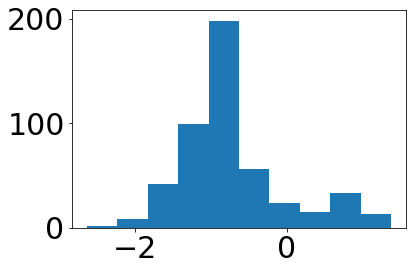

In [18]:
plt.hist(A[:,6])

Text(0.5, 0, 'w ($\\mu$m/s)')

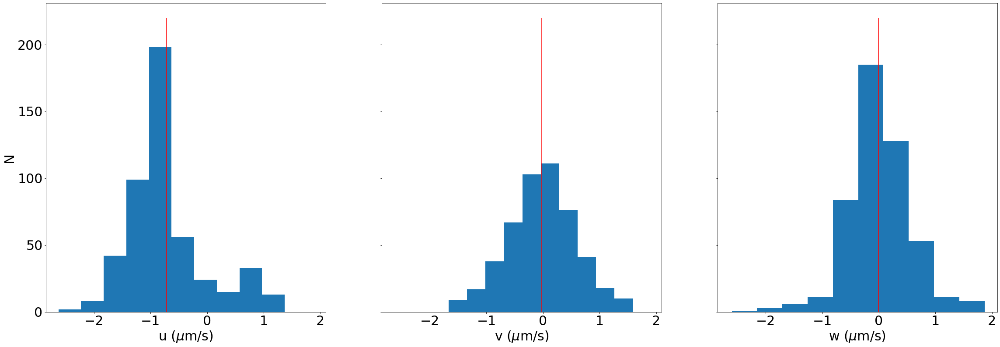

In [19]:
plt.rcParams.update({'font.size': 30})
fig, axs = plt.subplots(1,3, figsize=(39,13), sharex=True, sharey=True)
for ax, H in zip(axs, [A[:,6-i]for i in range(3)]):
    ax.hist(H)
    ax.vlines(H.mean(),0,220,color="r")

axs[0].set_ylabel("N",fontsize=30)
axs[0].set_xlabel("u ($\mu$m/s)",fontsize=30)
axs[1].set_xlabel("v ($\mu$m/s)",fontsize=30)
axs[2].set_xlabel("w ($\mu$m/s)",fontsize=30)


In [12]:
run /media/keho/T7/Git/gelrupture/export_profiles.py '/media/keho/My Book/Keho/Yaourt/20220525/Experiment_20220525.lif' location+"profiles"

39 Series
1721 (99.9 %) done!


In [312]:
run /media/keho/T7/Git/gelrupture/export_profiles.py '/media/keho/My Book/Keho/Yaourt/20220603/Experiment_20220603.lif' '/media/keho/My Book/Keho/Yaourt/20220603/profiles_20220603'

62 Series
1465 (99.9 %) done!


<Figure size 576x576 with 0 Axes>

In [319]:
run /media/keho/T7/Git/gelrupture/export_profiles.py '/media/keho/T7/Yaourt/20220316/20220316_bien.lif' '/media/keho/T7/Yaourt/20220316/profiles_20220316'

8 Series
494 (99.8 %) done!


<Figure size 576x576 with 0 Axes>

In [8]:
videolif+"/test"

'/media/keho/My Book/Keho/Yaourt/20220525/Experiment_20220525.lif/test'

In [11]:
videolif

'/media/keho/My Book/Keho/Yaourt/20220525/Experiment_20220525.lif'

In [13]:
run /media/keho/T7/Git/gelrupture/export_profiles.py '/media/keho/My Book/Keho/Yaourt/20220530/Experiment_20220530.lif' '/media/keho/My Book/Keho/Yaourt/20220530/profiles_20220530'

6 Series
304 (99.7 %) done!


In [40]:
run /media/keho/T7/Git/gelrupture/export_profiles.py '/media/keho/My Book/Keho/Yaourt/20220331/Experiment_20220331.lif' '/media/keho/My Book/Keho/Yaourt/20220331/profiles_20220331'

16 Series
511 (99.8 %) done!


In [9]:
run /media/keho/T7/Git/gelrupture/export_profiles.py '/media/keho/T7/Yaourt/20220614/Experiment_20220614.lif' '/media/keho/My Book/Keho/Yaourt/20220614/profiles_20220614'

13 Series
289 (99.7 %) done!


In [9]:
run /media/keho/T7/Git/gelrupture/export_profiles.py '/media/keho/T7/Yaourt/20220617/Experiment_20220617.lif' '/media/keho/My Book/Keho/Yaourt/20220617/profiles_20220617' -s 2

45 Series
1014 (99.9 %) done!


In [12]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220617/profiles_20220617.npy')
for profile in profiles[::1]:
    plt.plot(profile)
# plt.xlim([100,140])

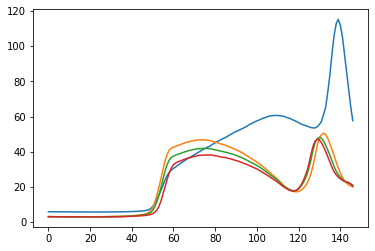

In [34]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220530/profiles_20220530.npy')
for profile in profiles[::100]:
    plt.plot(profile)
# plt.xlim([100,140])

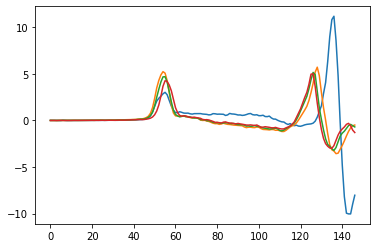

In [35]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220530/profiles_20220530.npy')
for profile in profiles[::100]:
    plt.plot(np.gradient(profile))
# plt.xlim([100,140])

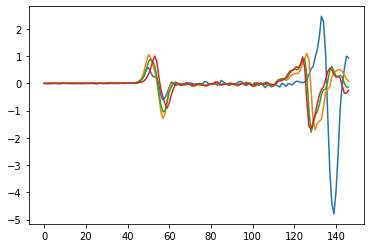

In [36]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220530/profiles_20220530.npy')
for profile in profiles[::100]:
    plt.plot(np.gradient(np.gradient(profile)))
# plt.xlim([100,140])

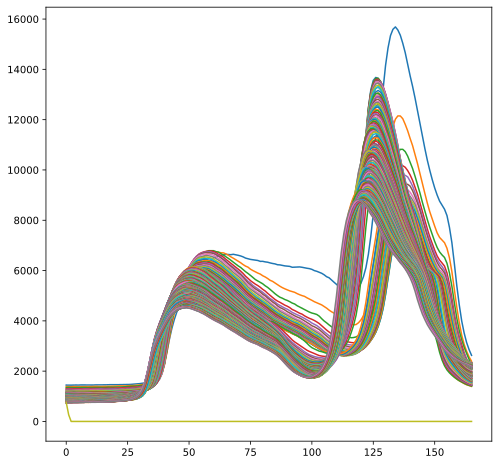

In [12]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220614/profiles_20220614.npy')
for profile in profiles[::1]:
    plt.plot(profile)
# plt.xlim([100,140])

In [ ]:
1er min grad grad
1er grad=0 ou argmin entre cf ligne au dessus et la fin

In [38]:
profiles[200]

array([ 3.21127319,  3.19816971,  3.18497086,  3.17882156,  3.16398239,
        3.14351654,  3.13991928,  3.14569092,  3.129776  ,  3.13684464,
        3.1334343 ,  3.13077545,  3.11888885,  3.11103058,  3.10892868,
        3.11341858,  3.10259628,  3.10709381,  3.10039139,  3.12136078,
        3.1157341 ,  3.11909866,  3.12866974,  3.1206398 ,  3.14614868,
        3.14971161,  3.15855789,  3.16721725,  3.17926788,  3.19076538,
        3.20775986,  3.21320343,  3.24380493,  3.27518845,  3.29432297,
        3.33118439,  3.37620926,  3.40589142,  3.45136261,  3.49967194,
        3.59052658,  3.65205383,  3.74879456,  3.86037064,  4.00098038,
        4.11390305,  4.30458069,  4.54479599,  4.95453644,  5.6031189 ,
        6.72087097,  8.73182678, 11.68478775, 15.40740585, 19.9196701 ,
       24.73200226, 29.27494812, 32.93373108, 35.45552063, 36.93395233,
       37.61328888, 38.18157959, 38.57855225, 38.92446518, 39.43085861,
       39.87518311, 40.20934296, 40.62343216, 40.94326782, 41.18

In [107]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220530/profiles_20220530.npy')
profiles=gaussian_filter(profiles,4)
debut=[]
fin=[]
for i, profile in enumerate(profiles):
    debut.append(argrelextrema(gaussian_filter(np.gradient(np.gradient(profile)),4),np.less)[0][0])
    fin.append((argrelextrema(profile[test1[0][0]:],np.less)[0]+debut[-1])[0])
debut=np.array(debut)
fin=np.array(fin)

In [108]:
fin

array([130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 130, 129,
       129, 129, 129, 129, 129, 129, 129, 129, 129, 129, 128, 128, 128,
       127, 127, 126, 125, 125, 124, 124, 123, 122, 122, 122, 122, 122,
       122, 122, 122, 122, 122, 122, 122, 123, 123, 123, 123, 123, 123,
       123, 123, 122, 122, 122, 122, 122, 120, 120, 120, 120, 120, 119,
       119, 119, 119, 119, 119, 119, 119, 119, 120, 121, 121, 121, 121,
       121, 121, 121, 121, 121, 121, 121, 121, 121, 121, 120, 120, 120,
       120, 120, 118, 118, 118, 118, 118, 118, 118, 118, 118, 118, 119,
       119, 119, 119, 120, 120, 120, 121, 121, 121, 122, 122, 122, 122,
       122, 122, 122, 123, 122, 122, 122, 122, 122, 121, 121, 121, 121,
       119, 119, 119, 119, 119, 119, 119, 118, 118, 118, 119, 119, 120,
       120, 120, 120, 120, 120, 120, 121, 121, 121, 121, 121, 121, 121,
       121, 121, 120, 120, 120, 120, 119, 118, 118, 118, 118, 118, 118,
       117, 117, 117, 117, 117, 118, 118, 119, 119, 119, 119, 11

In [179]:
len(profiles)

1721

In [7]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220316/profiles_20220316.npy')

In [42]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220331/profiles_20220331.npy')

In [72]:
profiles.shape

(511, 118)

IndexError: index 500 is out of bounds for axis 0 with size 494

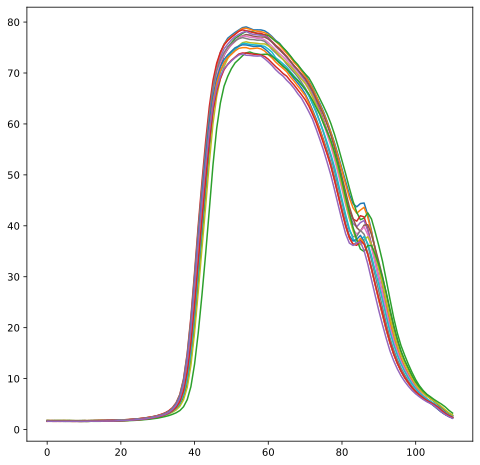

In [8]:
for profile in profiles[200:350:10]:
    plt.plot(profile)
p1=profiles[500]

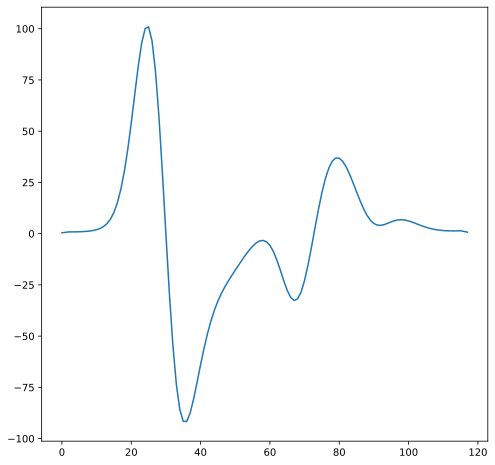

In [91]:
plt.plot(np.gradient(
         np.gradient(gaussian_filter(p1,4))))

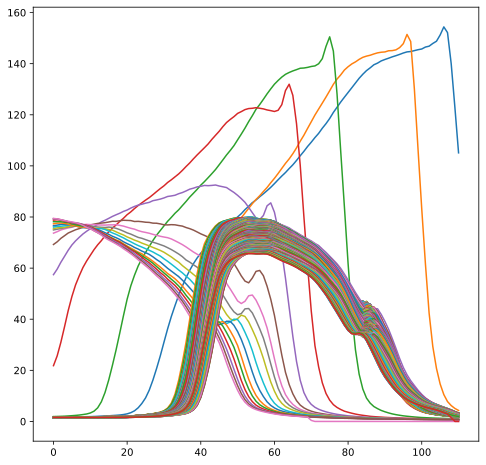

In [8]:
for profile in profiles:
    plt.plot(profile)

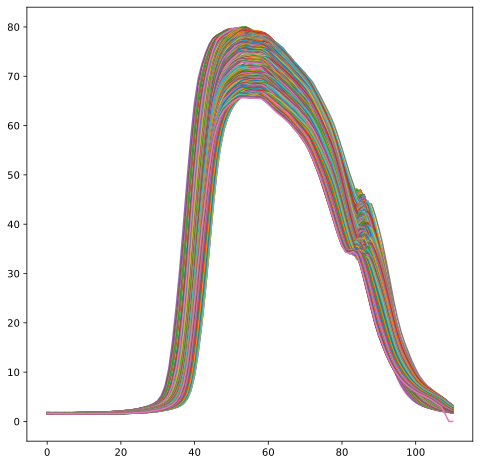

In [18]:
for profile in profiles[17:]:
    plt.plot(profile)

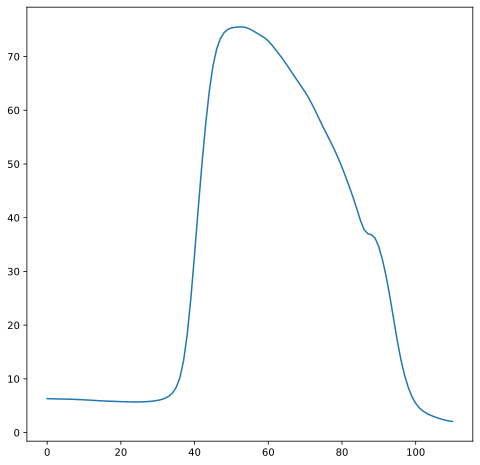

In [25]:
plt.plot(profiles[18])

(-5.0, 183.6)

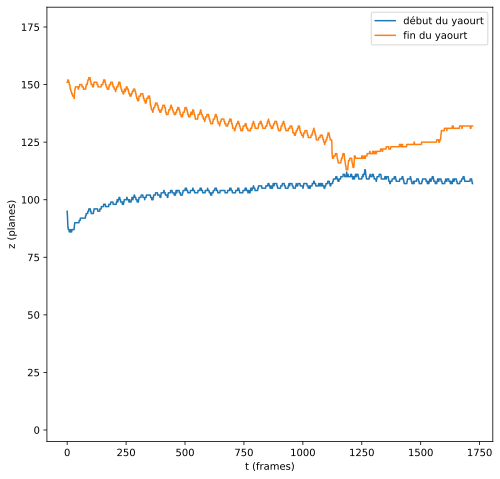

In [10]:
profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220525/profiles_20220525.npy')
profiles=gaussian_filter(profiles,1)
tronquerdebut=50
debut=[]
fin=[]
for i, profile in enumerate(((profiles.T)[tronquerdebut:]).T):
    debut.append([k for k in (argrelextrema(profile,np.greater))[0] if np.abs(profile[k])>np.max(profile)/4][0])
    fin.append((argrelextrema(profile[debut[-1]:],np.less)[0]+debut[-1])[0])
# print(fin)
debut=np.array(debut)+tronquerdebut
fin=np.array(fin)+tronquerdebut

plt.plot(debut,label="début du yaourt")
plt.plot(fin,label='fin du yaourt')
plt.legend()
plt.xlabel("t (frames)")
plt.ylabel("z (planes)")
plt.ylim([-5,np.max(fin)*1.2])
# plt.xlim([1180,1200])

(-5.0, 183.6)

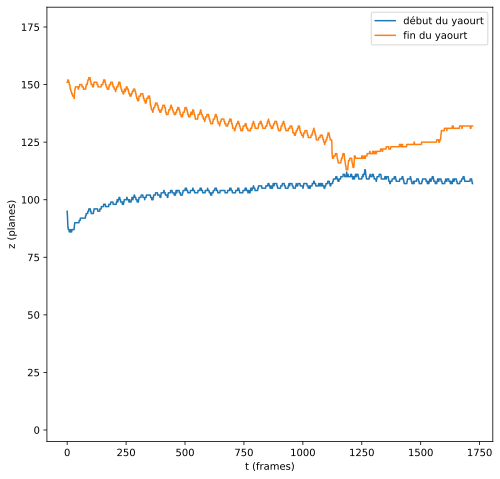

In [9]:
## Brouillon

profiles=np.load('/media/keho/My Book/Keho/Yaourt/20220525/profiles_20220525.npy')
profiles=gaussian_filter(profiles,1)
tronquerdebut=50
debut=[]
fin=[]
for i, profile in enumerate(((profiles.T)[tronquerdebut:]).T):
    # gpp=gaussian_filter(np.gradient(np.gradient(profile)),4)
    # print(gpp)
    # M=np.max(gpp)
    # debut.append(gpp[0][0])
    # debut.append(([k for k in (argrelextrema(gpp,np.less)[0]) if np.abs(ggp[k])>M/2])[0])
    # debut.append(np.argmax(profile))
    debut.append([k for k in (argrelextrema(profile,np.greater))[0] if np.abs(profile[k])>np.max(profile)/4][0])
    # print(i)
    # fin.append((argrelextrema(profile[debut[-1]:],np.less)[0]+debut[-1])[0])
    fin.append((argrelextrema(profile[debut[-1]:],np.less)[0]+debut[-1])[0])
# print(fin)
debut=np.array(debut)+tronquerdebut
fin=np.array(fin)+tronquerdebut

plt.plot(debut,label="début du yaourt")
plt.plot(fin,label='fin du yaourt')
plt.legend()
plt.xlabel("t (frames)")
plt.ylabel("z (planes)")
plt.ylim([-5,np.max(fin)*1.2])
# plt.xlim([1180,1200])

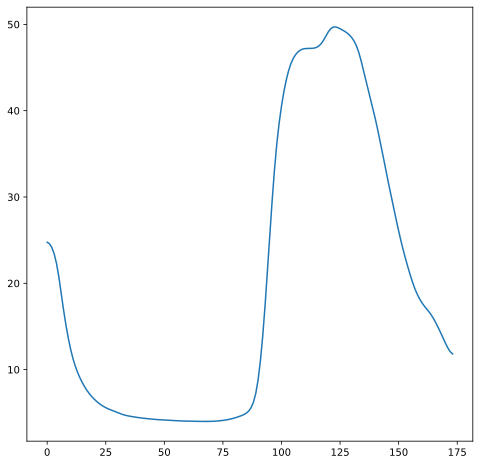

In [281]:
plt.plot(gaussian_filter(profiles[1186],1))
# plt.xlim([100,140])

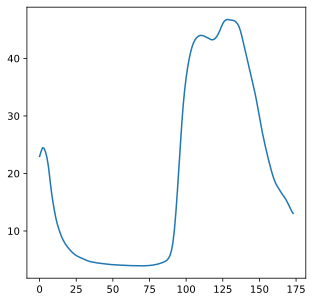

In [272]:
plt.plot(profiles[1200])
# plt.xlim([100,140])

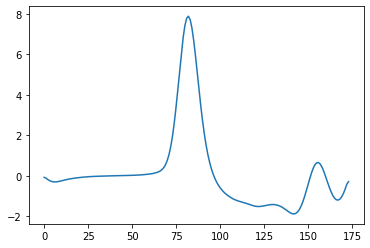

In [134]:
plt.plot(np.gradient(profiles[100]))

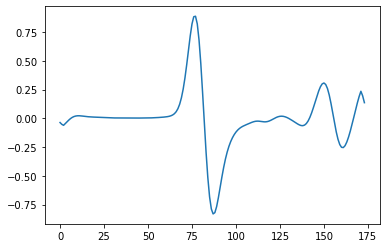

In [135]:
plt.plot(np.gradient(np.gradient(profiles[100])))

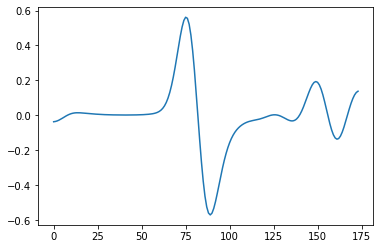

In [157]:
plt.plot(gaussian_filter(np.gradient(np.gradient(profiles[100])),4))

In [159]:
ggp=gaussian_filter(np.gradient(np.gradient(profiles[0])),4)
test1=argrelextrema(ggp,np.less)[0]
print(test1)
M=np.max(ggp)
test2=[k for k in test1 if np.abs(ggp[k])>M/2]
print(test2)

[ 34  83 125 163]
[83, 163]


In [149]:
ggp

array([-3.63585329e-02, -3.47636283e-02, -3.16730325e-02, -2.72860717e-02,
       -2.18979873e-02, -1.58828756e-02, -9.65987481e-03, -3.64602058e-03,
        1.79425896e-03,  6.39072536e-03,  9.99046136e-03,  1.25590495e-02,
        1.41626255e-02,  1.49378655e-02,  1.50581999e-02,  1.47030311e-02,
        1.40354621e-02,  1.31885210e-02,  1.22599089e-02,  1.13138116e-02,
        1.03874140e-02,  9.49942895e-03,  8.65738213e-03,  7.86391401e-03,
        7.12083330e-03,  6.43092876e-03,  5.79799632e-03,  5.22578436e-03,
        4.71660360e-03,  4.27022414e-03,  3.88344959e-03,  3.55048542e-03,
        3.26396813e-03,  3.01634444e-03,  2.80121620e-03,  2.61430373e-03,
        2.45380852e-03,  2.32013772e-03,  2.21513361e-03,  2.14108349e-03,
        2.09983104e-03,  2.09226158e-03,  2.11830625e-03,  2.17744769e-03,
        2.26956040e-03,  2.39582952e-03,  2.55948779e-03,  2.76619442e-03,
        3.02402956e-03,  3.34325774e-03,  3.73618909e-03,  4.21761314e-03,
        4.80638894e-03,  

In [144]:
test1

(array([ 41,  89, 135, 161]),)

In [132]:
print(argrelextrema(profiles[100,test1[0][0]:],np.less)[0]+test1[0][0])

[ 42 151]


In [125]:
test1[0][0]

41

In [137]:
L=[1,2,3,4]
k=2
[item for item in my_list if 1 <= item <=5 ]

SyntaxError: cannot delete comparison (2215216106.py, line 3)